<a href="https://colab.research.google.com/github/it21109126/lstm-text-classification/blob/main/BiLSTM_Text_Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Optional
!wget -O CNN_Articels_clean_2.csv https://media.githubusercontent.com/media/it21109126/lstm-text-classification/refs/heads/main/CNN_Articels_clean_2.csv?token=AU2RNF2T2ZPAUVW37SWQPALHALQ3M

--2024-10-06 18:16:57--  https://media.githubusercontent.com/media/it21109126/lstm-text-classification/refs/heads/main/CNN_Articels_clean_2.csv?token=AU2RNF2T2ZPAUVW37SWQPALHALQ3M
Resolving media.githubusercontent.com (media.githubusercontent.com)... 185.199.108.133, 185.199.109.133, 185.199.110.133, ...
Connecting to media.githubusercontent.com (media.githubusercontent.com)|185.199.108.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 240602056 (229M) [text/plain]
Saving to: ‘CNN_Articels_clean_2.csv’

CNN_Articels_clean_ 100%[===================>] 229.46M   296MB/s    in 0.8s    

2024-10-06 18:17:05 (296 MB/s) - ‘CNN_Articels_clean_2.csv’ saved [240602056/240602056]



# Data Collection and Exploration

In [2]:
import pandas as pd

In [3]:
# Load the dataset
df = pd.read_csv('CNN_Articels_clean_2.csv')
df.head()

,Index,Author,Date published,Category,Section,Url,Headline,Description,Keywords,Second headline,Article text
0,0,"Jacopo Prisco, CNN",2021-07-15 02:46:59,news,world,https://www.cnn.com/2021/07/14/world/tusimple-...,"There's a shortage of truckers, but TuSimple t...",The e-commerce boom has exacerbated a global t...,"world, There's a shortage of truckers, but TuS...","There's a shortage of truckers, but TuSimple t...","(CNN)Right now, there's a shortage of truck d..."
1,1,"Stephanie Bailey, CNN",2021-05-12 07:52:09,news,world,https://www.cnn.com/2021/05/12/world/ironhand-...,Bioservo's robotic 'Ironhand' could protect fa...,Working in a factory can mean doing the same t...,"world, Bioservo's robotic 'Ironhand' could pro...",A robotic 'Ironhand' could protect factory wor...,(CNN)Working in a factory or warehouse can me...
2,2,"Words by Stephanie Bailey, video by Zahra Jamshed",2021-06-16 02:51:30,news,asia,https://www.cnn.com/2021/06/15/asia/swarm-robo...,This swarm of robots gets smarter the more it ...,"In a Hong Kong warehouse, a swarm of autonomou...","asia, This swarm of robots gets smarter the mo...",This swarm of robots gets smarter the more it ...,"(CNN)In a Hong Kong warehouse, a swarm of aut..."
3,3,Kathryn Vasel,2022-03-18 14:37:21,business,success,https://www.cnn.com/2022/03/18/success/pandemi...,"Two years later, remote work has changed milli...",Here's a look at how the pandemic reshaped peo...,"success, Two years later, remote work has chan...","Two years later, remote work has changed milli...",The pandemic thrust the working world into a n...
4,4,"Paul R. La Monica, CNN Business",2022-03-19 11:41:08,business,investing,https://www.cnn.com/2022/03/19/investing/march...,Why March is so volatile for stocks - CNN,March Madness isn't just for college basketbal...,"investing, Why March is so volatile for stocks...",Why March is so volatile for stocks,New York (CNN Business)March Madness isn't jus...


In [4]:
# Inspect data types
df.dtypes

,0
Index,int64
Author,object
Date published,object
Category,object
Section,object
Url,object
Headline,object
Description,object
Keywords,object
Second headline,object


# Data Preprocessing
1. **Feature Selection:** Identify and select the most relevant features.
2. **Handling Missing/Duplicate Values:** Drop rows having missing/duplicate values.
3. **Text Cleaning:** Lowercasing, punctuation removal, stop words removal, and stemming/lemmatization.
4. **Tokenization:** Convert text to integer sequences.
5. **Padding:** Ensure sequences are of equal length.
6. **Label Encoding:** Encode labels into numerical format.

### Feature Selection

In [5]:
extracted_df = df[['Article text', 'Category']]
print(extracted_df.head())
print(f'Shape : {extracted_df.shape}')

                                        Article text  Category
0   (CNN)Right now, there's a shortage of truck d...      news
1   (CNN)Working in a factory or warehouse can me...      news
2   (CNN)In a Hong Kong warehouse, a swarm of aut...      news
3  The pandemic thrust the working world into a n...  business
4  New York (CNN Business)March Madness isn't jus...  business
Shape : (37949, 2)


### Handling Missing Values

In [6]:
# Check for missing values
missing_values = extracted_df.isnull().sum()
print(missing_values)

Article text    9
Category        0
dtype: int64


In [7]:
# Drop rows having missing values in either 'Article text' or 'Category' columns
extracted_df = extracted_df.dropna()
print(extracted_df.head())
print(f'Shape : {extracted_df.shape}')

                                        Article text  Category
0   (CNN)Right now, there's a shortage of truck d...      news
1   (CNN)Working in a factory or warehouse can me...      news
2   (CNN)In a Hong Kong warehouse, a swarm of aut...      news
3  The pandemic thrust the working world into a n...  business
4  New York (CNN Business)March Madness isn't jus...  business
Shape : (37940, 2)


### Handling Duplicate Values

In [8]:
# Check for duplicate values in 'Article text' column
duplicate_articles = extracted_df[extracted_df.duplicated(subset='Article text')]

# Get the number of duplicate articles
num_duplicate_articles = duplicate_articles.shape[0]
print(f'Number of duplicate articles: {num_duplicate_articles}')

Number of duplicate articles: 22


In [9]:
# Drop duplicate rows
extracted_df.drop_duplicates(subset=['Article text'], inplace=True)
print(extracted_df.head())
print(f'Shape : {extracted_df.shape}')

                                        Article text  Category
0   (CNN)Right now, there's a shortage of truck d...      news
1   (CNN)Working in a factory or warehouse can me...      news
2   (CNN)In a Hong Kong warehouse, a swarm of aut...      news
3  The pandemic thrust the working world into a n...  business
4  New York (CNN Business)March Madness isn't jus...  business
Shape : (37918, 2)


### Text Cleaning

In [10]:
import re

In [11]:
# Data cleaning function
def clean_text(text):
  text = re.sub(r'http\S+', '', text)  # Remove URLs
  text = re.sub(r'<.*?>', '', text)    # Remove HTML tags
  text = re.sub(r'[^a-zA-Z\s]', '', text)  # Remove special characters and numbers
  text = re.sub(r'[\x00-\x1F\x7F-\x9F]', '', text) # Remove control characters
  text = text.strip() # Remove leading and trailing whitespaces
  text = text.lower()  # Convert to lowercase
  return text

In [12]:
# Clean the data
extracted_df['cleaned_text'] = extracted_df['Article text'].astype(str).apply(clean_text)
print(extracted_df.head())
print(f'Shape : {extracted_df.shape}')

                                        Article text  Category  \
0   (CNN)Right now, there's a shortage of truck d...      news   
1   (CNN)Working in a factory or warehouse can me...      news   
2   (CNN)In a Hong Kong warehouse, a swarm of aut...      news   
3  The pandemic thrust the working world into a n...  business   
4  New York (CNN Business)March Madness isn't jus...  business   

                                        cleaned_text  
0  cnnright now theres a shortage of truck driver...  
1  cnnworking in a factory or warehouse can mean ...  
2  cnnin a hong kong warehouse a swarm of autonom...  
3  the pandemic thrust the working world into a n...  
4  new york cnn businessmarch madness isnt just f...  
Shape : (37918, 3)


In [13]:
import nltk
nltk.download('wordnet')

from nltk.stem import WordNetLemmatizer

[nltk_data] Downloading package wordnet to /root/nltk_data...


In [14]:
# Text normalization via lemmatization
lemmatizer = WordNetLemmatizer()

def lemmatize_text(text):
  return ' '.join([lemmatizer.lemmatize(word) for word in text.split()])

extracted_df['lemmatized_text'] = extracted_df['cleaned_text'].apply(lemmatize_text)
print(extracted_df.head())
print(f'Shape : {extracted_df.shape}')

                                        Article text  Category  \
0   (CNN)Right now, there's a shortage of truck d...      news   
1   (CNN)Working in a factory or warehouse can me...      news   
2   (CNN)In a Hong Kong warehouse, a swarm of aut...      news   
3  The pandemic thrust the working world into a n...  business   
4  New York (CNN Business)March Madness isn't jus...  business   

                                        cleaned_text  \
0  cnnright now theres a shortage of truck driver...   
1  cnnworking in a factory or warehouse can mean ...   
2  cnnin a hong kong warehouse a swarm of autonom...   
3  the pandemic thrust the working world into a n...   
4  new york cnn businessmarch madness isnt just f...   

                                     lemmatized_text  
0  cnnright now there a shortage of truck driver ...  
1  cnnworking in a factory or warehouse can mean ...  
2  cnnin a hong kong warehouse a swarm of autonom...  
3  the pandemic thrust the working world into 

In [15]:
nltk.download('stopwords')
from nltk.corpus import stopwords

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [16]:
# Removing stop words (common words like 'is, are' etc.)
stop_words = set(stopwords.words('english'))

def remove_stopwords(text):
    return ' '.join([word for word in text.split() if word not in stop_words])

extracted_df['final_text'] = extracted_df['lemmatized_text'].apply(remove_stopwords)
print(extracted_df.head())
print(f'Shape : {extracted_df.shape}')

                                        Article text  Category  \
0   (CNN)Right now, there's a shortage of truck d...      news   
1   (CNN)Working in a factory or warehouse can me...      news   
2   (CNN)In a Hong Kong warehouse, a swarm of aut...      news   
3  The pandemic thrust the working world into a n...  business   
4  New York (CNN Business)March Madness isn't jus...  business   

                                        cleaned_text  \
0  cnnright now theres a shortage of truck driver...   
1  cnnworking in a factory or warehouse can mean ...   
2  cnnin a hong kong warehouse a swarm of autonom...   
3  the pandemic thrust the working world into a n...   
4  new york cnn businessmarch madness isnt just f...   

                                     lemmatized_text  \
0  cnnright now there a shortage of truck driver ...   
1  cnnworking in a factory or warehouse can mean ...   
2  cnnin a hong kong warehouse a swarm of autonom...   
3  the pandemic thrust the working world i

### Tokenization

In [17]:
from tensorflow.keras.preprocessing.text import Tokenizer

In [18]:
# Tokenization
tokenizer = Tokenizer()
tokenizer.fit_on_texts(extracted_df['final_text'])
print(f'Vocabulary: {tokenizer.word_index}')
print(f'Vocabulary Size: {len(tokenizer.word_index)}')

Vocabulary: {'wa': 1, 'photo': 2, 'said': 3, 'caption': 4, 'ha': 5, 'year': 6, 'world': 7, 'one': 8, 'people': 9, 'hide': 10, 'u': 11, 'first': 12, 'time': 13, 'say': 14, 'would': 15, 'also': 16, 'new': 17, 'best': 18, 'two': 19, 'day': 20, 'team': 21, 'last': 22, 'told': 23, 'state': 24, 'video': 25, 'like': 26, 'must': 27, 'country': 28, 'game': 29, 'could': 30, 'woman': 31, 'police': 32, 'cnn': 33, 'president': 34, 'player': 35, 'open': 36, 'ukraine': 37, 'win': 38, 'may': 39, 'back': 40, 'get': 41, 'cup': 42, 'take': 43, 'match': 44, 'according': 45, 'right': 46, 'make': 47, 'second': 48, 'home': 49, 'week': 50, 'government': 51, 'many': 52, 'city': 53, 'three': 54, 'since': 55, 'made': 56, 'russia': 57, 'family': 58, 'story': 59, 'life': 60, 'united': 61, 'way': 62, 'league': 63, 'final': 64, 'champion': 65, 'russian': 66, 'think': 67, 'official': 68, 'going': 69, 'go': 70, 'still': 71, 'group': 72, 'trump': 73, 'come': 74, 'former': 75, 'crisis': 76, 'even': 77, 'month': 78, 'clu

### Padding

In [19]:
from tensorflow.keras.preprocessing.sequence import pad_sequences

In [20]:
# Convert texts to sequences
sequences = tokenizer.texts_to_sequences(extracted_df['final_text'])

# Pad sequences to ensure uniform length
max_length = max([len(seq) for seq in sequences])
padded_sequences = pad_sequences(sequences, maxlen=max_length, padding='post')
padded_sequences

array([[113505,   3214,   1248, ...,      0,      0,      0],
       [113512,   2941,   5851, ...,      0,      0,      0],
       [  4194,   1100,   1231, ...,      0,      0,      0],
       ...,
       [ 35874,     63,   2112, ...,      0,      0,      0],
       [   156,     60,   5950, ...,      0,      0,      0],
       [ 12573,    156,     60, ...,      0,      0,      0]], dtype=int32)

### Label Encoding

In [21]:
from sklearn.preprocessing import LabelEncoder

In [22]:
# Label Encoding
label_encoder = LabelEncoder()
extracted_df['category_encoded'] = label_encoder.fit_transform(extracted_df['Category'])
print(extracted_df.head())
print(f'Shape : {extracted_df.shape}')

                                        Article text  Category  \
0   (CNN)Right now, there's a shortage of truck d...      news   
1   (CNN)Working in a factory or warehouse can me...      news   
2   (CNN)In a Hong Kong warehouse, a swarm of aut...      news   
3  The pandemic thrust the working world into a n...  business   
4  New York (CNN Business)March Madness isn't jus...  business   

                                        cleaned_text  \
0  cnnright now theres a shortage of truck driver...   
1  cnnworking in a factory or warehouse can mean ...   
2  cnnin a hong kong warehouse a swarm of autonom...   
3  the pandemic thrust the working world into a n...   
4  new york cnn businessmarch madness isnt just f...   

                                     lemmatized_text  \
0  cnnright now there a shortage of truck driver ...   
1  cnnworking in a factory or warehouse can mean ...   
2  cnnin a hong kong warehouse a swarm of autonom...   
3  the pandemic thrust the working world i

In [23]:
# Get unique encoded categories and their corresponding original categories
unique_categories = extracted_df[['Category','category_encoded']].drop_duplicates()
print(unique_categories)

           Category  category_encoded
0              news                 3
3          business                 0
30           health                 2
34    entertainment                 1
64            sport                 5
144        politics                 4
2762         travel                 7
4634             vr                 8
4647          style                 6


### Final Data Summary

In [ ]:
# Format of the final data after complete preprocessing
extracted_df.head()

,Article text,Category,cleaned_text,lemmatized_text,final_text,category_encoded
0,"(CNN)Right now, there's a shortage of truck d...",news,cnnright now theres a shortage of truck driver...,cnnright now there a shortage of truck driver ...,cnnright shortage truck driver u worldwide exa...,3
1,(CNN)Working in a factory or warehouse can me...,news,cnnworking in a factory or warehouse can mean ...,cnnworking in a factory or warehouse can mean ...,cnnworking factory warehouse mean task repetit...,3
2,"(CNN)In a Hong Kong warehouse, a swarm of aut...",news,cnnin a hong kong warehouse a swarm of autonom...,cnnin a hong kong warehouse a swarm of autonom...,cnnin hong kong warehouse swarm autonomous rob...,3
3,The pandemic thrust the working world into a n...,business,the pandemic thrust the working world into a n...,the pandemic thrust the working world into a n...,pandemic thrust working world new reality marc...,0
4,New York (CNN Business)March Madness isn't jus...,business,new york cnn businessmarch madness isnt just f...,new york cnn businessmarch madness isnt just f...,new york cnn businessmarch madness isnt colleg...,0


In [ ]:
# Summary statistics of the final data after complete preprocessing
print(f'Data Types: \n{extracted_df.dtypes}')
print(f'\nShape: {extracted_df.shape}')
print(f'\nUnique Categories: {extracted_df["category_encoded"].nunique()}')
print(f'\nNull Values: \n{extracted_df.isnull().sum()}')
print(f'\nDuplicate Rows: {extracted_df.duplicated().sum()}')
print(f'\nVocabulary: {tokenizer.word_index}')
print(f'\nVocabulary Size: {len(tokenizer.word_index)}')
print(f'\nMax Sequence Length: {max_length}')

Data Types: 
Article text        object
Category            object
cleaned_text        object
lemmatized_text     object
final_text          object
category_encoded     int64
dtype: object

Shape: (37918, 6)

Unique Categories: 9

Null Values: 
Article text        0
Category            0
cleaned_text        0
lemmatized_text     0
final_text          0
category_encoded    0
dtype: int64

Duplicate Rows: 0

Vocabulary: {'wa': 1, 'photo': 2, 'said': 3, 'caption': 4, 'ha': 5, 'year': 6, 'world': 7, 'one': 8, 'people': 9, 'hide': 10, 'u': 11, 'first': 12, 'time': 13, 'say': 14, 'would': 15, 'also': 16, 'new': 17, 'best': 18, 'two': 19, 'day': 20, 'team': 21, 'last': 22, 'told': 23, 'state': 24, 'video': 25, 'like': 26, 'must': 27, 'country': 28, 'game': 29, 'could': 30, 'woman': 31, 'police': 32, 'cnn': 33, 'president': 34, 'player': 35, 'open': 36, 'ukraine': 37, 'win': 38, 'may': 39, 'back': 40, 'get': 41, 'cup': 42, 'take': 43, 'match': 44, 'according': 45, 'right': 46, 'make': 47, 'sec

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from wordcloud import WordCloud

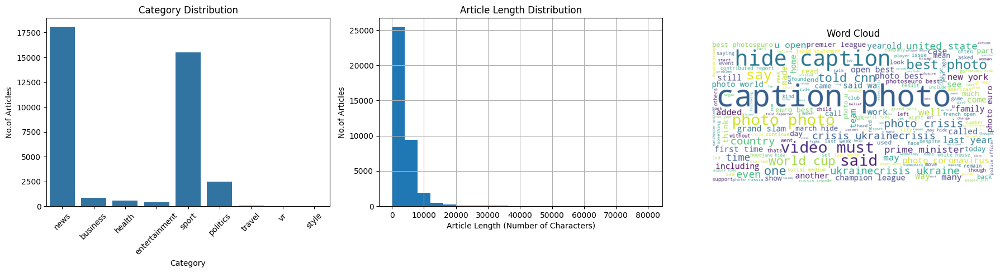

In [ ]:
# Some visualizations of the final data

# Create a figure with 3 subplots arranged horizontally
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

# 1. Category Distribution (Bar chart)
sns.countplot(x='Category', data=extracted_df, ax=axes[0])
axes[0].set_title('Category Distribution')
axes[0].set_xlabel('Category')
axes[0].set_ylabel('No.of Articles')
# Rotate x-axis labels and adjust their position
axes[0].tick_params(axis='x', labelrotation=45) # Rotate labels by 45 degrees

# 2. Article Length Distribution (Histogram)
extracted_df['final_text'].str.len().hist(bins=20, ax=axes[1])
axes[1].set_title('Article Length Distribution')
axes[1].set_xlabel('Article Length (Number of Characters)')
axes[1].set_ylabel('No.of Articles')

# 3. Word Cloud
all_text = ' '.join(extracted_df['final_text'].astype(str).tolist())
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(all_text)
axes[2].imshow(wordcloud, interpolation='bilinear')
axes[2].axis('off')
axes[2].set_title('Word Cloud')

# Adjust spacing between subplots
plt.tight_layout()
# Display the figure
plt.show()

# Model Building and Training

In [25]:
from sklearn.model_selection import train_test_split

In [26]:
X = padded_sequences
y = extracted_df['category_encoded']

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, shuffle=True, random_state=42)

# Further split training data into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.2, shuffle=True, random_state=42)

In [ ]:
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Embedding, LSTM, Dense, Bidirectional, Dropout, Input
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.regularizers import l2

### Model Building

In [ ]:
# Hyperparameter grid for GridSearchCSV
param_grid = {
    'embedding_dim': [16, 32],
    'lstm_units': [16, 32],
    'learning_rate': [0.01],
    'dropout_rate': [0.5],
    'l2_regularization': [0.05]
}

output_units = extracted_df['category_encoded'].nunique()

# Function to create the Bi-LSTM model
def create_bilstm_model(embedding_dim=32, lstm_units=32, learning_rate=0.01, dropout_rate=0.5, l2_regularization=0.05):
  model = Sequential([
      Input(shape=(max_length,)),
      Embedding(input_dim=len(tokenizer.word_index) + 1, output_dim=embedding_dim),
      Bidirectional(
          LSTM(lstm_units, return_sequences=True)
      ),
      Dropout(dropout_rate),
      Bidirectional(
          LSTM(lstm_units)
      ),
      Dense(output_units, activation='softmax', kernel_regularizer=l2(l2_regularization))
  ])
  # Compile the model
  model.compile(optimizer=Adam(learning_rate=learning_rate), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
  return model

In [ ]:
!pip install scikeras
from scikeras.wrappers import KerasClassifier

### Hyperparameter Tuning - GridSearchCV Approach

In [ ]:
# Use KerasClassifier to wrap the model for scikeras
model = KerasClassifier(
    build_fn=create_bilstm_model,
    verbose=0,
    # Provide default values for hyperparameters
    embedding_dim=32,
    lstm_units=16,
    learning_rate=0.01,
    dropout_rate=0.3,
    l2_regularization=0.01
)

In [ ]:
from sklearn.model_selection import GridSearchCV

In [ ]:
# Initialize and fit GridSearchCV
grid = GridSearchCV(estimator=model, param_grid=param_grid, cv=3, scoring='accuracy', verbose=1)
grid_result = grid.fit(X_train, y_train)

Fitting 3 folds for each of 4 candidates, totalling 12 fits


/usr/local/lib/python3.10/dist-packages/sklearn/model_selection/_split.py:776: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=3.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/scikeras/wrappers.py:925: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/usr/local/lib/python3.10/dist-packages/scikeras/wrappers.py:925: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/usr/local/lib/python3.10/dist-packages/scikeras/wrappers.py:925: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/usr/local/lib/python3.10/dist-packages/scikeras/wrappers.py:925: UserWarning: ``build_fn`` wil

In [ ]:
# Get the best parameters and model
print(f'Best Score: {grid_result.best_score_}')
print(f'Best Params: {grid_result.best_params_}')
grid_result.best_estimator_

Best Score: 0.8789302344748012
Best Params: {'dropout_rate': 0.5, 'embedding_dim': 16, 'l2_regularization': 0.05, 'learning_rate': 0.01, 'lstm_units': 32}


KerasClassifier(
	model=None
	build_fn=<function create_bilstm_model at 0x7e2988364ee0>
	warm_start=False
	random_state=None
	optimizer=rmsprop
	loss=None
	metrics=None
	batch_size=None
	validation_batch_size=None
	verbose=0
	callbacks=None
	validation_split=0.0
	shuffle=True
	run_eagerly=False
	epochs=1
	embedding_dim=16
	lstm_units=32
	learning_rate=0.01
	dropout_rate=0.5
	l2_regularization=0.05
	class_weight=None
)

In [ ]:
# Create best model
best_params = grid_result.best_params_
best_model = create_bilstm_model(
    best_params['embedding_dim'],
    best_params['lstm_units'],
    best_params['learning_rate'],
    best_params['dropout_rate'],
    best_params['l2_regularization']
)
best_model.summary()

Model: "sequential_13"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ embedding_13 (Embedding)             │ (None, 10340, 16)           │      10,475,728 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ bidirectional_26 (Bidirectional)     │ (None, 10340, 64)           │          12,544 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_13 (Dropout)                 │ (None, 10340, 64)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ bidirectional_27 (Bidirectional)     │ (None, 64)                  │          24,832 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_13 (Dense)                     │ (None, 9)                   │             585 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 10,513,689 (40.11 MB)

 Trainable params: 10,513,689 (40.11 MB)

 Non-trainable params: 0 (0.00 B)

### Hyperparameter Tuning - Manual Approach

In [ ]:
# Hyperparameters
embedding_dim = 32
lstm_units = embedding_dim
learning_rate = 0.01
dropout_rate = 0.5
l2_regularization = 0.05

# Create manual model
model = create_bilstm_model(embedding_dim, lstm_units, learning_rate, dropout_rate, l2_regularization)
model.summary()

Model: "sequential_15"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ embedding_15 (Embedding)             │ (None, 10340, 32)           │      20,951,456 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ bidirectional_30 (Bidirectional)     │ (None, 10340, 64)           │          16,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_15 (Dropout)                 │ (None, 10340, 64)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ bidirectional_31 (Bidirectional)     │ (None, 64)                  │          24,832 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_15 (Dense)                     │ (None, 9)                   │             585 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 20,993,513 (80.08 MB)

 Trainable params: 20,993,513 (80.08 MB)

 Non-trainable params: 0 (0.00 B)

### Model Training

In [27]:
from tensorflow.keras.callbacks import EarlyStopping, ReduceLROnPlateau

In [28]:
# Hyperparameters
batch_size = 100
epochs = 20

# Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

In [ ]:
# Train the best model
best_history = best_model.fit(X_train, y_train, epochs=epochs, validation_data=(X_val, y_val), batch_size=batch_size, callbacks=[early_stopping])

Epoch 1/20
243/243 ━━━━━━━━━━━━━━━━━━━━ 359s 1s/step - accuracy: 0.8411 - loss: 0.6608 - val_accuracy: 0.8889 - val_loss: 0.4942
Epoch 2/20
243/243 ━━━━━━━━━━━━━━━━━━━━ 323s 1s/step - accuracy: 0.9024 - loss: 0.4385 - val_accuracy: 0.8960 - val_loss: 0.4641
Epoch 3/20
243/243 ━━━━━━━━━━━━━━━━━━━━ 295s 1s/step - accuracy: 0.9236 - loss: 0.3714 - val_accuracy: 0.9075 - val_loss: 0.4162
Epoch 4/20
243/243 ━━━━━━━━━━━━━━━━━━━━ 332s 1s/step - accuracy: 0.9344 - loss: 0.3257 - val_accuracy: 0.9069 - val_loss: 0.4445
Epoch 5/20
243/243 ━━━━━━━━━━━━━━━━━━━━ 316s 1s/step - accuracy: 0.9436 - loss: 0.2948 - val_accuracy: 0.9120 - val_loss: 0.4229
Epoch 6/20
243/243 ━━━━━━━━━━━━━━━━━━━━ 345s 1s/step - accuracy: 0.9505 - loss: 0.2766 - val_accuracy: 0.9016 - val_loss: 0.4400
Epoch 7/20
243/243 ━━━━━━━━━━━━━━━━━━━━ 353s 1s/step - accuracy: 0.9494 - loss: 0.2754 - val_accuracy: 0.8920 - val_loss: 0.4533
Epoch 8/20
243/243 ━━━━━━━━━━━━━━━━━━━━ 322s 1s/step - accuracy: 0.9618 - loss: 0.2457 - val_accu

In [ ]:
# Train the manual model
history = model.fit(X_train, y_train, epochs=epochs, validation_data=(X_val, y_val), batch_size=batch_size, callbacks=[early_stopping])

Epoch 1/20
243/243 ━━━━━━━━━━━━━━━━━━━━ 304s 1s/step - accuracy: 0.7428 - loss: 0.9764 - val_accuracy: 0.8597 - val_loss: 0.6092
Epoch 2/20
243/243 ━━━━━━━━━━━━━━━━━━━━ 293s 1s/step - accuracy: 0.9030 - loss: 0.4589 - val_accuracy: 0.8925 - val_loss: 0.4653
Epoch 3/20
243/243 ━━━━━━━━━━━━━━━━━━━━ 322s 1s/step - accuracy: 0.9178 - loss: 0.3779 - val_accuracy: 0.8957 - val_loss: 0.4417
Epoch 4/20
243/243 ━━━━━━━━━━━━━━━━━━━━ 335s 1s/step - accuracy: 0.9360 - loss: 0.3223 - val_accuracy: 0.9072 - val_loss: 0.4213
Epoch 5/20
243/243 ━━━━━━━━━━━━━━━━━━━━ 306s 1s/step - accuracy: 0.9522 - loss: 0.2854 - val_accuracy: 0.9072 - val_loss: 0.4369
Epoch 6/20
243/243 ━━━━━━━━━━━━━━━━━━━━ 324s 1s/step - accuracy: 0.9568 - loss: 0.2656 - val_accuracy: 0.9105 - val_loss: 0.4198
Epoch 7/20
243/243 ━━━━━━━━━━━━━━━━━━━━ 321s 1s/step - accuracy: 0.9626 - loss: 0.2455 - val_accuracy: 0.9149 - val_loss: 0.4139
Epoch 8/20
243/243 ━━━━━━━━━━━━━━━━━━━━ 323s 1s/step - accuracy: 0.9628 - loss: 0.2406 - val_accu

# Model Evaluation

### Accuracy and Loss

In [ ]:
import matplotlib.pyplot as plt

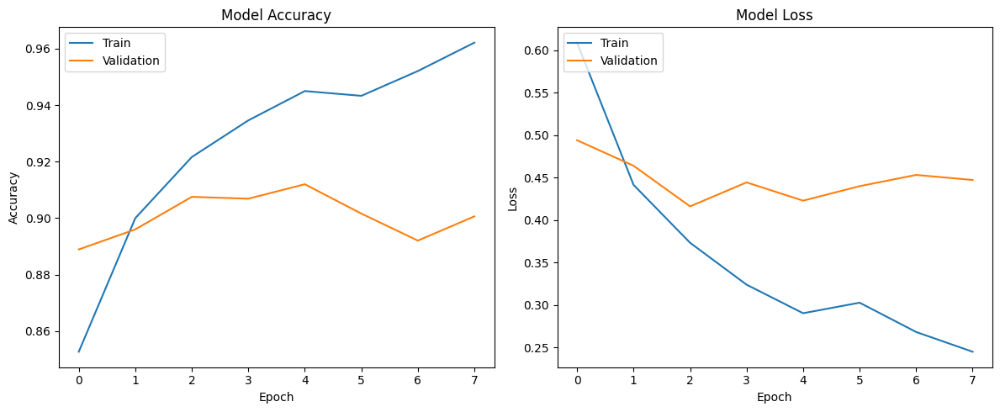

In [ ]:
# For the best model

# Create a figure with two subplots
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 5))

# Model Accuracy
ax1.plot(best_history.history['accuracy'])
ax1.plot(best_history.history['val_accuracy'])
ax1.set_title('Model Accuracy')
ax1.set_ylabel('Accuracy')
ax1.set_xlabel('Epoch')
ax1.legend(['Train', 'Validation'], loc='upper left')

# Model Loss
ax2.plot(best_history.history['loss'])
ax2.plot(best_history.history['val_loss'])
ax2.set_title('Model Loss')
ax2.set_ylabel('Loss')
ax2.set_xlabel('Epoch')
ax2.legend(['Train', 'Validation'], loc='upper left')

# Adjust spacing between subplots
plt.tight_layout()

# Display the figure
plt.show()

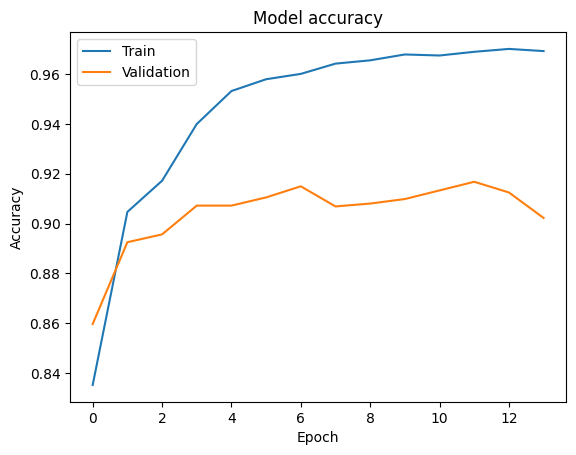

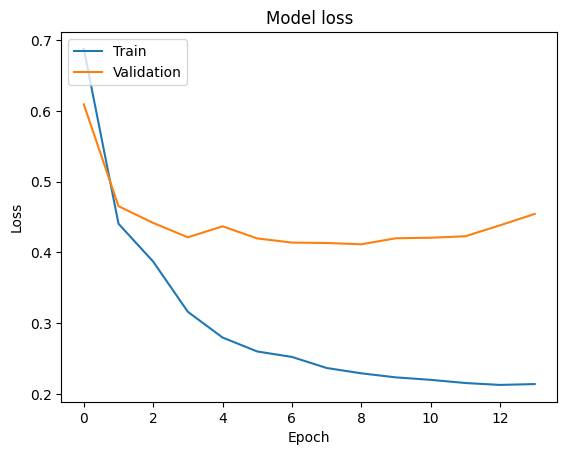

In [ ]:
# For the manual model
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['Train', 'Validation'], loc='upper left')
plt.show()

In [ ]:
# Save the trained models (Optional)
best_model.save('trained_bilstm_best_model.keras')
model.save('trained_bilstm_model.keras')

In [29]:
from tensorflow.keras.models import load_model

# Load the pretrained models (Optional)
best_model = load_model('trained_bilstm_best_model.keras')
model = load_model('trained_bilstm_model.keras')

### Evaluate on Test Data

In [ ]:
# Best model
test_loss, test_accuracy = best_model.evaluate(X_test, y_test, batch_size=batch_size)
print('===== Best Model =====')
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}\n')

76/76 ━━━━━━━━━━━━━━━━━━━━ 35s 464ms/step - accuracy: 0.8995 - loss: 0.4507
===== Best Model =====
Test Loss: 0.43839895725250244
Test Accuracy: 0.904140293598175



In [30]:
# Manual model
test_loss, test_accuracy = model.evaluate(X_test, y_test, batch_size=batch_size)
print('===== Manual Model =====')
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

76/76 ━━━━━━━━━━━━━━━━━━━━ 38s 463ms/step - accuracy: 0.9122 - loss: 0.3999
===== Manual Model =====
Test Loss: 0.390817254781723
Test Accuracy: 0.9146888256072998


### Classification Reports and Confusion Matrices

In [36]:
from sklearn.metrics import classification_report
import seaborn as sns
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt

In [37]:
# For the best model
# Predict classes for the test data
y_pred = best_model.predict(X_test, batch_size=batch_size)
y_pred_classes = y_pred.argmax(axis=1)

76/76 ━━━━━━━━━━━━━━━━━━━━ 35s 462ms/step


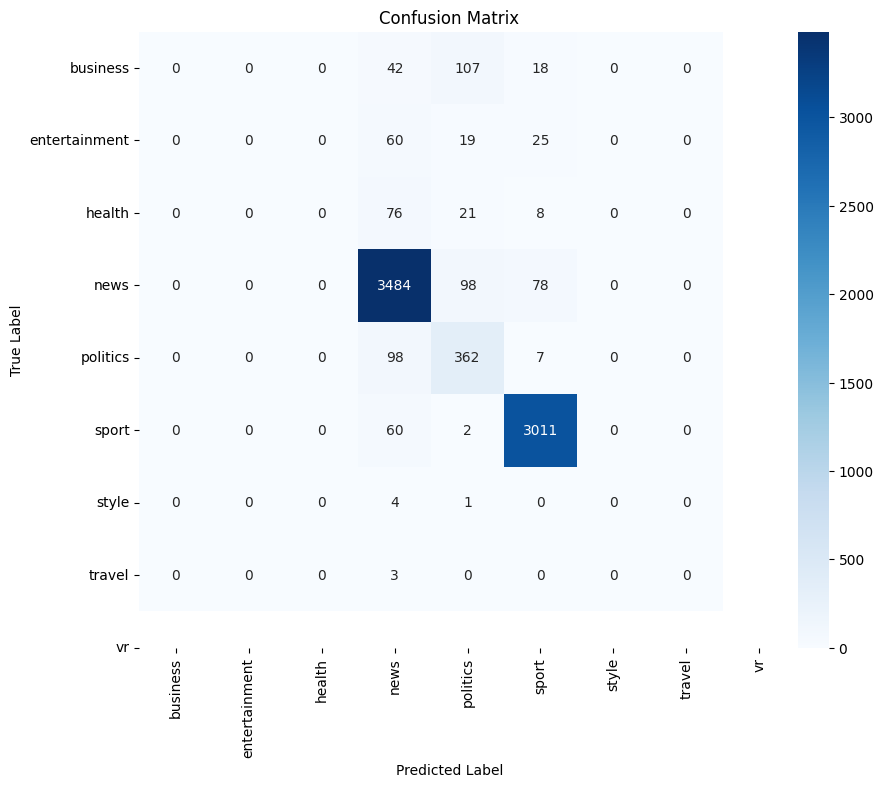

In [38]:
# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred_classes)

# Plot confusion matrix using Seaborn heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

In [39]:
# For the manual model
# Predict classes for the test data
y_pred = model.predict(X_test, batch_size=batch_size)
y_pred_classes = y_pred.argmax(axis=1)

76/76 ━━━━━━━━━━━━━━━━━━━━ 36s 464ms/step


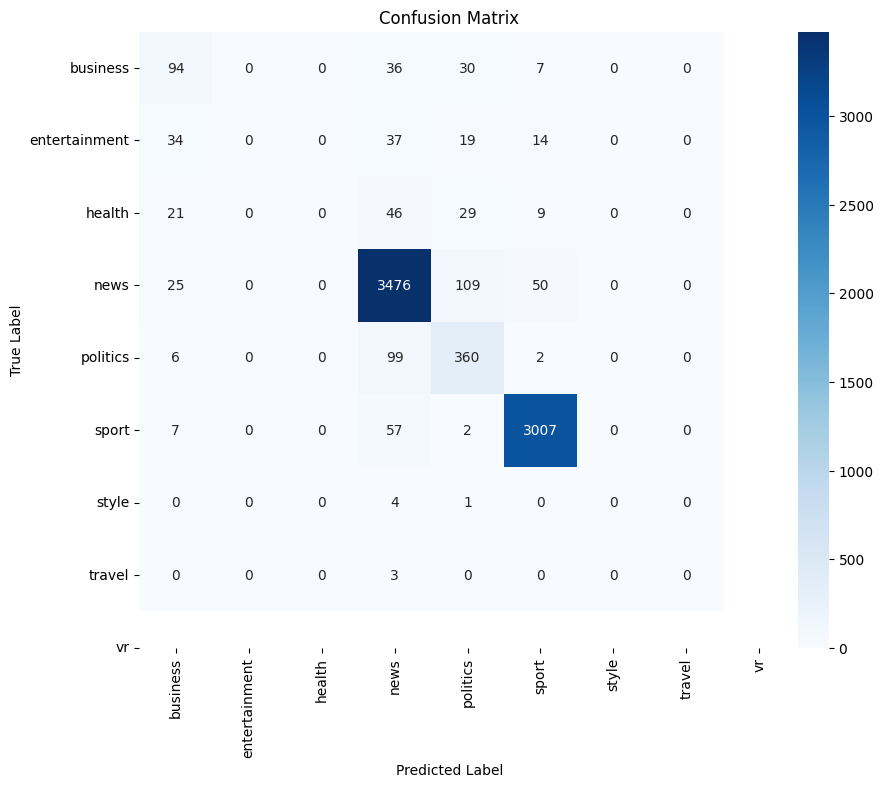

In [40]:
# Generate confusion matrix
cm = confusion_matrix(y_test, y_pred_classes)

# Plot confusion matrix using Seaborn heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=label_encoder.classes_, yticklabels=label_encoder.classes_)
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()